In [1]:
import scanpy as sc
import scIB
from scipy.sparse.csgraph import connected_components
import numpy as np
import matplotlib.pyplot as plt

In [2]:
import matplotlib

In [3]:
matplotlib.rcParams['figure.figsize'] = [12, 12]

In [4]:
import seaborn as sns
sns.set_context('poster')

In [5]:
import warnings
warnings.filterwarnings("ignore")

In [6]:
import pandas as pd

In [217]:
def change_ct(adata):
    adata.obs.loc[adata.obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'
    adata.obs['final_annotation'] = adata.obs['final_annotation'].cat.remove_unused_categories()

In [96]:
def run_pp(adata, adata_int, type_, changeCT = False):
    # DATA REDUCTION
    # select options according to type
    
    if changeCT:
        adata.obs.loc[adata.obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'
        adata_int.obs.loc[adata_int.obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'
        
    if len(set(adata.obs_names).difference(set(adata_int.obs_names))) > 0:
        #rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_int.obs_names]

        if len(set(adata.obs_names).difference(set(new_obs_names))) == 0:
            adata_int.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')
    
    if adata.n_vars > adata_int.n_vars:
        n_hvgs = None
    
    # case 1: full expression matrix, default settings
    precompute_pca = True
    recompute_neighbors = True
    embed = 'X_pca'
    n_hvgs=2000
    
    # distinguish between subsetted and full expression matrix
    # compute HVGs only if output is not already subsetted
    if adata.n_vars > adata_int.n_vars:
        n_hvgs = None
    
    # case 2: embedding output
    if (type_ == "embed"):
        n_hvgs = None
        embed = "X_emb"
        # legacy check
        if ('emb' in adata_int.uns) and (adata_int.uns['emb']):
            adata_int.obsm["X_emb"] = adata_int.obsm["X_pca"].copy()
    
    # case3: kNN graph output
    elif (type_ == "knn"):
        n_hvgs = None
        precompute_pca = False
        recompute_neighbors = False
    
    
    scIB.preprocessing.reduce_data(adata_int,
                                   n_top_genes=n_hvgs,
                                   neighbors=recompute_neighbors, use_rep=embed,
                                   pca=precompute_pca, umap=False)

def get_root(adata_pre, adata_post, ct_key, dpt_dim=3):
    n_components, adata_post.obs['neighborhood'] = connected_components(csgraph=adata_post.uns['neighbors']['connectivities'], directed=False, return_labels=True)
    
    start_clust = adata_pre.obs.groupby([ct_key]).mean()['dpt_pseudotime'].idxmin()
    min_dpt = np.flatnonzero(adata_pre.obs[ct_key] == start_clust)
    max_neigh = np.flatnonzero(adata_post.obs['neighborhood']== adata_post.obs['neighborhood'].value_counts().argmax())
    min_dpt = [value for value in min_dpt if value in max_neigh]
    
    # compute Diffmap for adata_post
    sc.tl.diffmap(adata_post)
    
    # determine most extreme cell in adata_post Diffmap
    min_dpt_cell = np.zeros(len(min_dpt))
    for dim in np.arange(dpt_dim):
        
        diffmap_mean = adata_post.obsm["X_diffmap"][:, dim].mean()
        diffmap_min_dpt = adata_post.obsm["X_diffmap"][min_dpt, dim]
        
        # choose optimum function
        if diffmap_min_dpt.mean() < diffmap_mean:
            opt = np.argmin
        else:
            opt = np.argmax
        # count opt cell
        min_dpt_cell[opt(diffmap_min_dpt)] += 1
    
    # root cell is cell with max vote
    return min_dpt[np.argmax(min_dpt_cell)]

def trajectory_plot(adata_pre, adata_post, label_key, type_, label, ax, orig=False, changeCT=False):
    if len(set(adata_pre.obs_names).difference(set(adata_post.obs_names))) > 0:
        #rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_post.obs_names]

        if len(set(adata_pre.obs_names).difference(set(new_obs_names))) == 0:
            adata_post.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')
    run_pp(adata_pre, adata_post, type_, changeCT=changeCT)
    
    cell_subset = adata_pre.obs.index[adata_pre.obs["dpt_pseudotime"].notnull()]
    adata_pre_sub = adata_pre[cell_subset]
    adata_post_sub = adata_post[cell_subset]
    
    adata_post_sub.uns['iroot'] = get_root(adata_pre_sub, adata_post_sub, label_key)
    
    sc.tl.dpt(adata_post_sub)
    #adata_post_sub.obs['dpt_pseudotime'][adata_post_sub.obs['dpt_pseudotime']>1]=0
    #return (adata_post_sub.obs['dpt_pseudotime'].corr(adata_pre_sub.obs['dpt_pseudotime'], 'spearman')+1)/2
    #adata_pre_sub.obs['dpt_after'] = adata_post_sub.obs['dpt_pseudotime']
    if True:
        adata_post_sub.obs['dpt_after'] = pd.Series(range(len(adata_post_sub.obs)), index=adata_post_sub.obs.sort_values('dpt_pseudotime').index)
        #adata_post_wo = adata_post_sub[adata_post_sub.obs.dpt_pseudotime!=0]
        if 'conos' in label:
            sc.tl.draw_graph(adata_post_sub)
            sc.pl.umap(adata_post_sub, color='dpt_after', title=label, show=False, frameon=False, ax=ax)
        else:    
            sc.tl.umap(adata_post_sub)
            sc.pl.umap(adata_post_sub, color='dpt_after', title=label, show=False, frameon=False, ax=ax)

    else:
        adata_pre_draw.obs['dpt_after'] = pd.Series(range(len(adata_pre_draw.obs)), index=adata_post_sub.obs.sort_values('dpt_pseudotime').index)
        #sc.tl.umap(adata_pre_draw)
        sc.pl.umap(adata_pre_draw, color='dpt_after', title=label, show=False, frameon=False, ax=ax)
    return adata_pre_sub, adata_post_sub

In [97]:
def run_pp(adata, adata_int, type_, batch_key='study', changeCT=False):
    empty_file = False
    n_hvgs=None

    if (n_hvgs is not None):
        if (adata_int.n_vars < n_hvgs):
            raise ValueError("There are less genes in the uncorrected adata than specified for HVG selection")

    # check input files                                                                                                                                                                   
    if adata.n_obs != adata_int.n_obs:
        message = "The datasets have different numbers of cells before and after integration."
        message += "Please make sure that both datasets match."
        raise ValueError(message)

    #check if the obsnames were changed and rename them in that case                                                                                                                      
    if len(set(adata.obs_names).difference(set(adata_int.obs_names))) > 0:
        #rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels                                                                                       
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_int.obs_names]

        if len(set(adata.obs_names).difference(set(new_obs_names))) == 0:
            adata_int.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')

    # check input files                                                                                                                                                                   
    if adata.n_obs != adata_int.n_obs:
        message = "The datasets have different numbers of cells before and after integration."
        message += "Please make sure that both datasets match."
        raise ValueError(message)

    #check if the obsnames were changed and rename them in that case                                                                                                                      
    if len(set(adata.obs_names).difference(set(adata_int.obs_names))) > 0:
        #rename adata_int.obs[batch_key] labels by overwriting them with the pre-integration labels                                                                                       
        new_obs_names = ['-'.join(idx.split('-')[:-1]) for idx in adata_int.obs_names]

        if len(set(adata.obs_names).difference(set(new_obs_names))) == 0:
            adata_int.obs_names = new_obs_names
        else:
            raise ValueError('obs_names changed after integration!')

    #batch_key might be overwritten, so we match it to the pre-integrated labels                                                                                                          
    #adata_int.obs[batch_key] = adata_int.obs[batch_key].astype('category')
    #if not np.array_equal(adata.obs[batch_key].cat.categories,adata_int.obs[batch_key].cat.categories):
    #    #pandas uses the table index to match the correct labels                                                                                                                          
    #    adata_int.obs[batch_key] = adata.obs[batch_key]
    #    #print(adata.obs[batch_key].value_counts())                                                                                                                                       
    #    #print(adata_int.obs[batch_key].value_counts())                                                                                                                                   


    if (n_hvgs is not None) and (adata_int.n_vars < n_hvgs):
        # check number of HVGs to be computed                                                                                                                                             
        message = "There are fewer genes in the uncorrected adata "
        message += "than specified for HVG selection."
        raise ValueError(message)
        
    # distinguish between subsetted and full expression matrix                                                                                                                            
# compute HVGs only if output is not already subsetted                                                                                                                                
    if adata.n_vars > adata_int.n_vars:
        n_hvgs = None
        
    # case 1: full expression matrix, default settings                                                                                                                                    
    precompute_pca = True
    recompute_neighbors = True
    embed = 'X_pca'

    # case 2: embedding output                                                                                                                                                            
    if (type_ == "embed"):
        n_hvgs = None
        embed = "X_emb"
        # legacy check                                                                                                                                                                    
        if ('emb' in adata_int.uns) and (adata_int.uns['emb']):
            adata_int.obsm["X_emb"] = adata_int.obsm["X_pca"].copy()

    # case3: kNN graph output                                                                                                                                                             
    elif (type_ == "knn"):
        n_hvgs = None
        precompute_pca = False
        recompute_neighbors = False

    if not empty_file:
        scIB.preprocessing.reduce_data(adata_int,
                                       n_top_genes=n_hvgs,
                                       neighbors=recompute_neighbors, use_rep=embed,
                                       pca=precompute_pca, umap=False)



In [106]:
def make_grid():
    fig = plt.figure(constrained_layout=True, figsize=[40,12])
    gs = fig.add_gridspec(2, 6)
    axs = []
    axs.append(fig.add_subplot(gs[:,0:2]))
    axs.append(fig.add_subplot(gs[0,2]))
    axs.append(fig.add_subplot(gs[0,3]))
    axs.append(fig.add_subplot(gs[0,4]))
    axs.append(fig.add_subplot(gs[0,5]))
    axs.append(fig.add_subplot(gs[1,2]))
    axs.append(fig.add_subplot(gs[1,3]))
    axs.append(fig.add_subplot(gs[1,4]))
    axs.append(fig.add_subplot(gs[1,5]))
    return fig, axs

In [375]:
# Visualization loop
def viz(adatas_best, adatas_worst, var, axs, diffmap=False):
    #fig, axs = plt.subplots(2, 4, figsize=(40,16))
    start = 1
    for key in adatas_best:
        print(key)
        dat = adatas_best[key]
        fig_t = None
        if diffmap:
            dat_tmp = dat[dat.obs['dpt_pseudotime']>= 0]
            dat_tmp = dat_tmp[dat_tmp.obs.dpt_pseudotime<1]
            sc.tl.diffmap(dat_tmp)
            sc.pl.diffmap(dat_tmp, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False, components=[0,3])
        elif 'con'in key:
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        else:
            sc.pl.umap(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        fig_t = plt.gcf()
        if len(fig_t.axes)==11:
            plt.delaxes(fig_t.axes[-1])
        #fig_t.tight_layout()
        start+=1
    #start=0
    for key in adatas_worst:
        dat = adatas_worst[key]
        
        if diffmap:
            dat_tmp = dat[dat.obs['dpt_pseudotime']>= 0]
            dat_tmp = dat_tmp[dat_tmp.obs.dpt_pseudotime<1]
            sc.tl.diffmap(dat_tmp)
            sc.pl.diffmap(dat_tmp, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False, components=[0,3])
        elif 'con'in key:
            print('conos draw graph')
            sc.pl.draw_graph(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        else:
            sc.pl.umap(dat, color=var, size=10, title=key, legend_loc="", legend_fontsize='small', ax=axs[start], show=False, frameon=False)
        fig_t = plt.gcf()
        if len(fig_t.axes)==11:
            plt.delaxes(fig_t.axes[-1])
        #fig_t.tight_layout()
        start+=1
    #plt.savefig('figures/integrated.svg')
        #sc.pl.umap(dat, color=ct_key, size=20, title=key)

In [10]:
def final_plot(adata_u, base, adatas, adatas_type, save=None, changeCT=False):
    fig, axs = plt.subplots(2, 4, figsize=(40,16))
    start = 0
    out = {}
    for i in range(len(adatas)):
        tmp = sc.read(base+adatas[i])
        name = adatas[i].split(".")[0]+" "+adatas_type[i]
        pre, out[name] = trajectory_plot(adata_u, tmp, 'final_annotation', adatas_type[i], adatas[i].split(".")[0]+" "+adatas_type[i], ax=axs[0,start], orig=True)
        if 'conos' in name:
            sc.pl.draw_graph(out[name], color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc="", title="")
        else:
            sc.pl.umap(out[name], color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc="", title="")
        start +=1
    if save is not None:
        fig.savefig(save)
    sc.tl.umap(pre)
    sc.pl.umap(pre, color="final_annotation", frameon=False, palette=sc.pl.palettes.vega_10)
    sc.pl.umap(pre, color="dpt_pseudotime", frameon=False)
    return pre, out

In [11]:
h_unintegrated = '/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_human.h5ad'
h_adata_u = sc.read(h_unintegrated)
scIB.pp.reduce_data(h_adata_u)

HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours
UMAP


In [12]:
hm_adata_u = sc.read('/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_hum_mou.h5ad')
scIB.pp.reduce_data(hm_adata_u)

HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours
UMAP


In [13]:
h_best_all = ['scaled/hvg/scanorama.h5ad', 'unscaled/hvg/R/conos.h5ad', 'unscaled/hvg/bbknn.h5ad', 'unscaled/hvg/R/harmony.h5ad']
h_best_all_type = ['embed', 'knn', 'knn', 'embed']

In [14]:
h_worst_all = ['unscaled/hvg/trvae.h5ad', 'unscaled/full_feature/R/seurat.h5ad', 'unscaled/hvg/R/liger.h5ad', 'unscaled/full_feature/scvi.h5ad']
h_worst_all_type = ['embed', 'gene', 'embed', 'embed']

In [15]:
hm_best_all = ['scaled/hvg/scanorama.h5ad', 'unscaled/hvg/bbknn.h5ad', 'unscaled/full_feature/combat.h5ad', 'scaled/hvg/mnn.h5ad']
hm_best_all_type = ['embed', 'knn', 'full', 'full']

In [16]:
hm_worst_all = ['scaled/hvg/R/conos.h5ad', 'unscaled/full_feature/R/harmony.h5ad', 'unscaled/full_feature/R/liger.h5ad', 'unscaled/full_feature/scvi.h5ad']
hm_worst_all_type = ['knn', 'embed', 'embed', 'embed']

In [17]:
hm_methods_best = ['scaled/full_feature/combat.h5ad', 'scaled/full_feature/mnn.h5ad', 'unscaled/full_feature/R/harmony.h5ad', 'scaled/full_feature/scanorama.h5ad']
hm_types_best = ['full', 'full', 'embed', 'embed']
hm_methods_worst = ['unscaled/hvg/combat.h5ad', 'unscaled/full_feature/R/liger.h5ad', 'unscaled/full_feature/R/conos.h5ad', 'unscaled/full_feature/scvi.h5ad']
hm_types_worst = ['full', 'embed', 'knn', 'embed']

In [18]:
h_methods_best = ['unscaled/full_feature/scanorama.h5ad', 'unscaled/full_feature/R/conos.h5ad', 'unscaled/full_feature/trvae.h5ad', 'unscaled/full_feature/mnn.h5ad']
h_types_best = ['embed', 'knn', 'embed', 'full']
h_methods_worst = ['unscaled/full_feature/scvi.h5ad', 'unscaled/hvg/R/liger.h5ad', 'unscaled/hvg/R/seurat.h5ad', 'scaled/full_feature/scanorama.h5ad']
h_types_worst = ['embed', 'embed', 'full', 'full']

In [21]:
h_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/integration/'

In [28]:
hm_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum_mou/integration/'

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.
Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


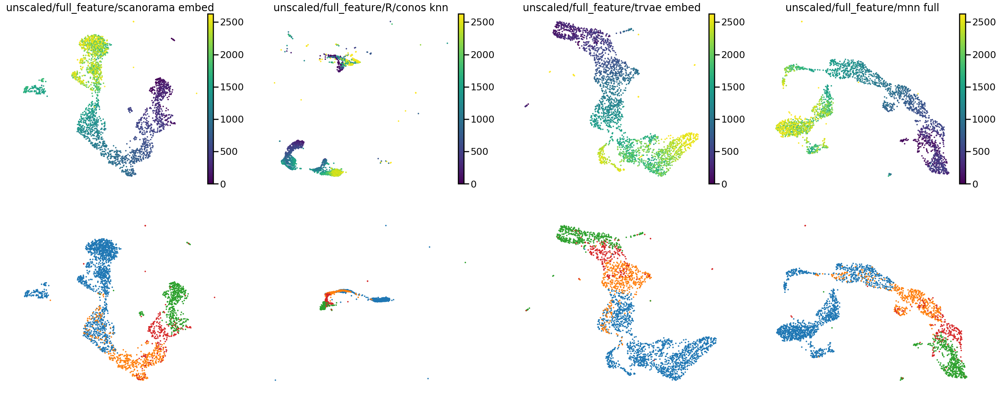

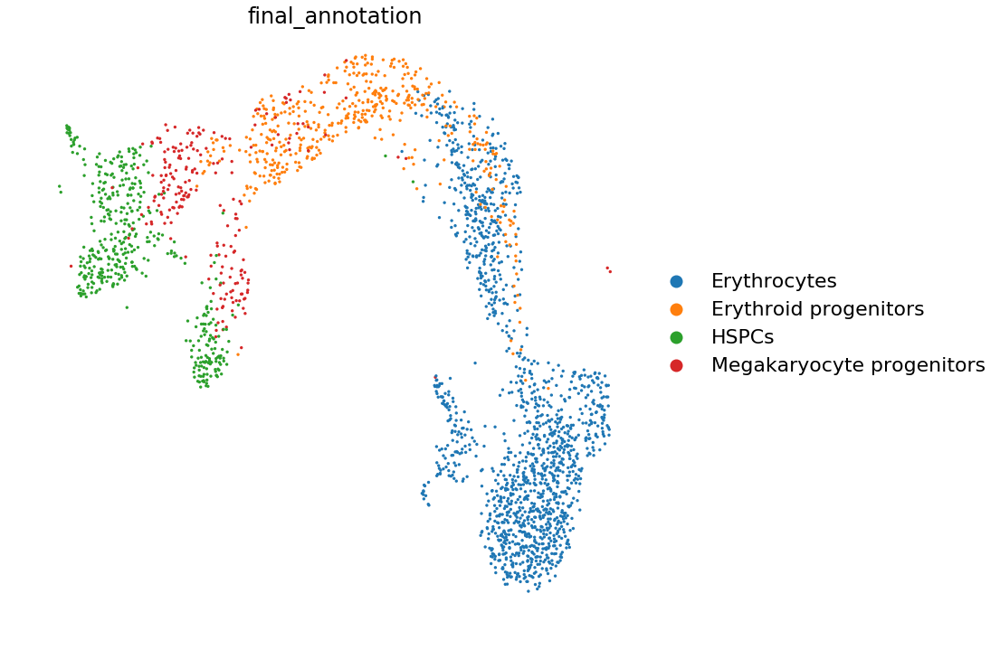

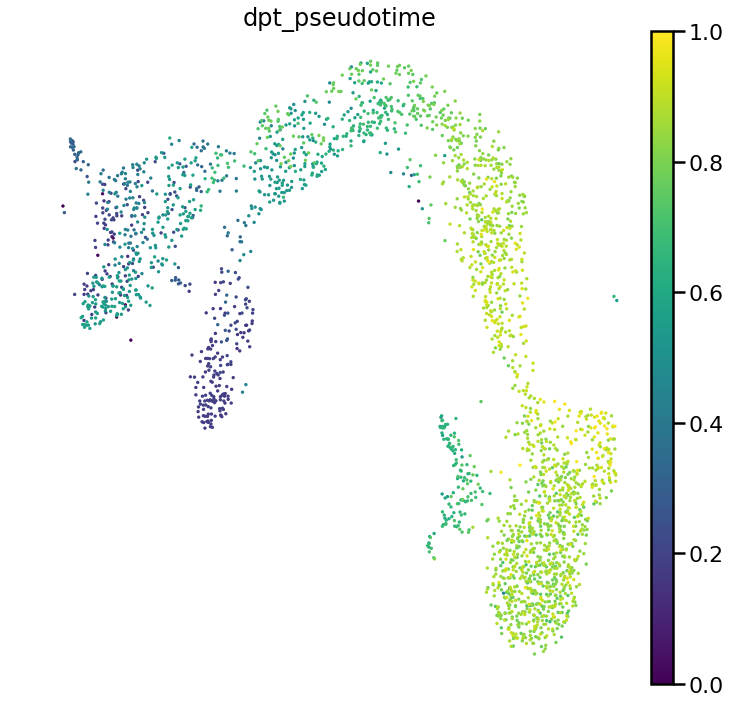

In [98]:
h_out_best = final_plot(h_adata_u, h_base, h_methods_best, h_types_best, save='h_best.pdf')

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


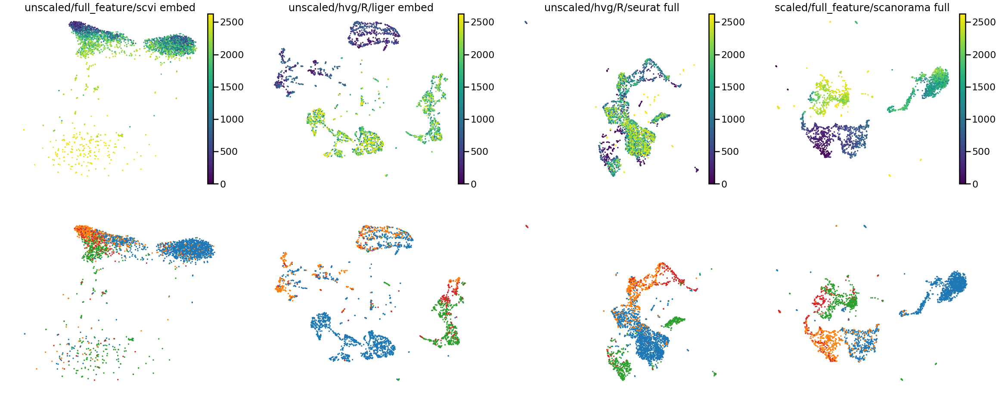

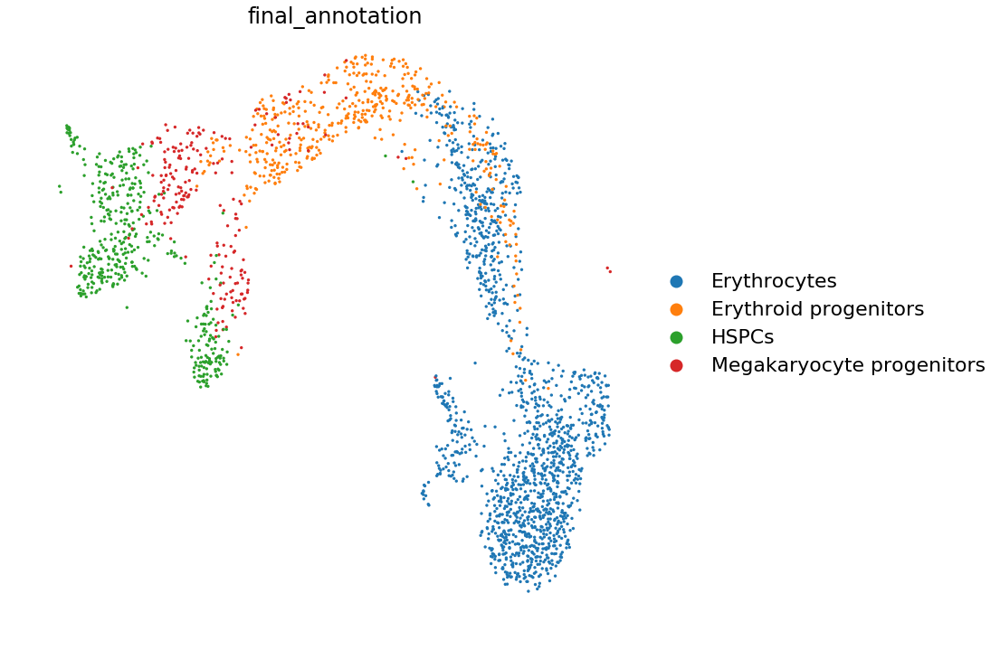

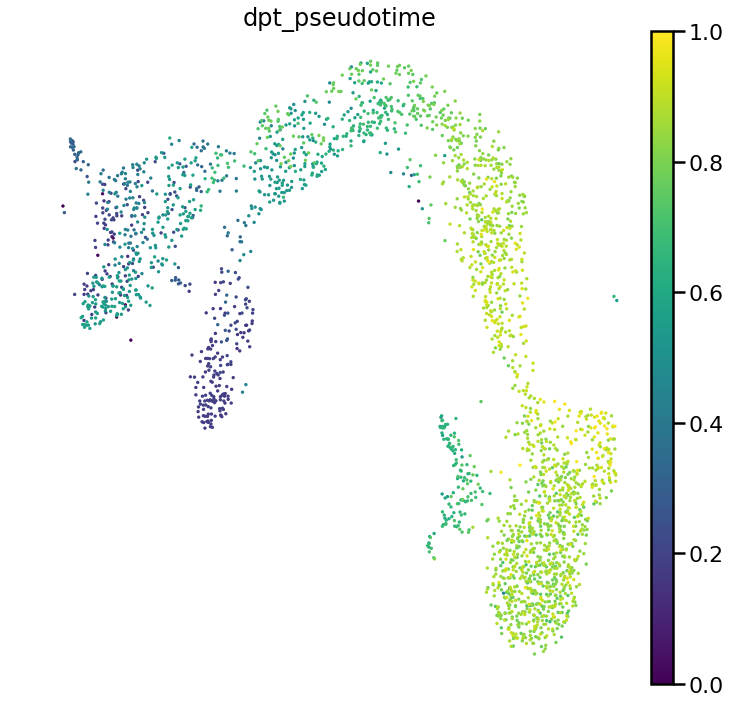

In [26]:
h_out_worst = final_plot(h_adata_u, h_base, h_methods_worst, h_types_worst, save='h_best.pdf')

unscaled/full_feature/scanorama embed
unscaled/full_feature/R/conos knn
conos draw graph
unscaled/full_feature/trvae embed
unscaled/full_feature/mnn full


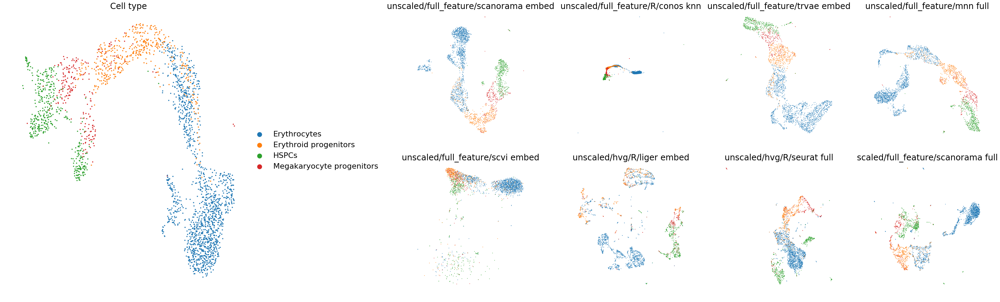

In [196]:
fig, a1 = make_grid()
sc.pl.umap(h_out_best[0], color='final_annotation', ax=a1[0], frameon=False, show=False, title='Cell type')
viz(h_out_best[1], h_out_worst[1], 'final_annotation', a1)

unscaled/full_feature/scanorama embed
unscaled/full_feature/R/conos knn
conos draw graph
unscaled/full_feature/trvae embed
unscaled/full_feature/mnn full


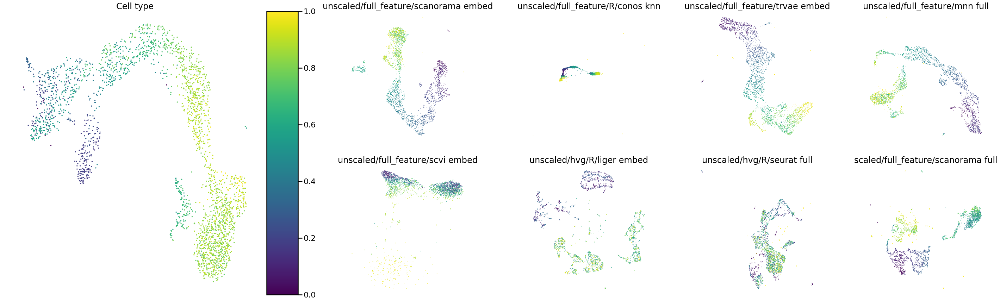

In [198]:
fig, a1 = make_grid()
sc.pl.umap(h_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Cell type')
viz(h_out_best[1], h_out_worst[1], 'dpt_after', a1)

unscaled/full_feature/scanorama embed
unscaled/full_feature/R/conos knn
unscaled/full_feature/trvae embed
unscaled/full_feature/mnn full


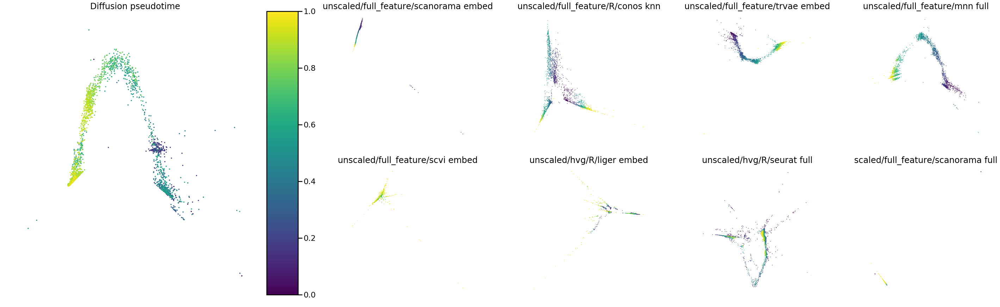

In [299]:
fig, a1 = make_grid()
#sc.pl.umap(h_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Cell type')
sc.tl.diffmap(h_out_best[0])
sc.pl.diffmap(h_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Diffusion pseudotime')
viz(h_out_best[1], h_out_worst[1], 'dpt_after', a1, diffmap=True)

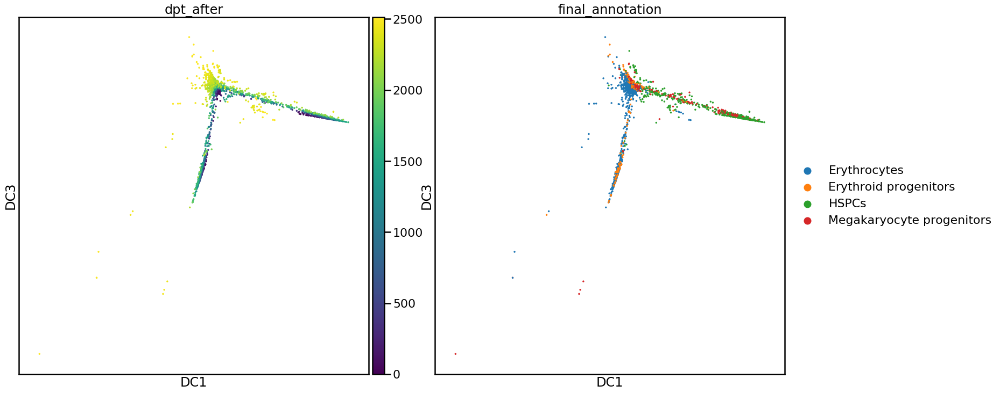

In [364]:
tmp = h_out_worst_all[1]['unscaled/full_feature/R/seurat gene'][h_out_worst_all[1]['unscaled/full_feature/R/seurat gene'].obs['dpt_pseudotime']>=0]
tmp = tmp[tmp.obs.dpt_pseudotime<1]
sc.tl.diffmap(tmp)
sc.pl.diffmap(tmp, color=['dpt_after', 'final_annotation'], components=[1,3])

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


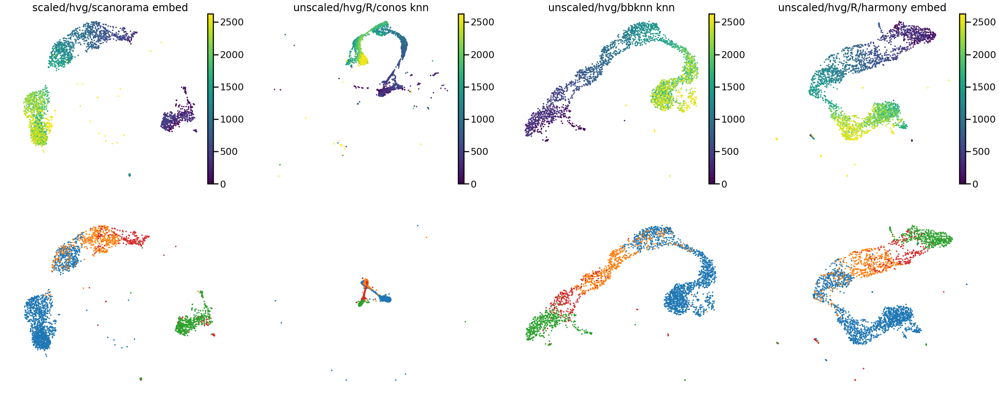

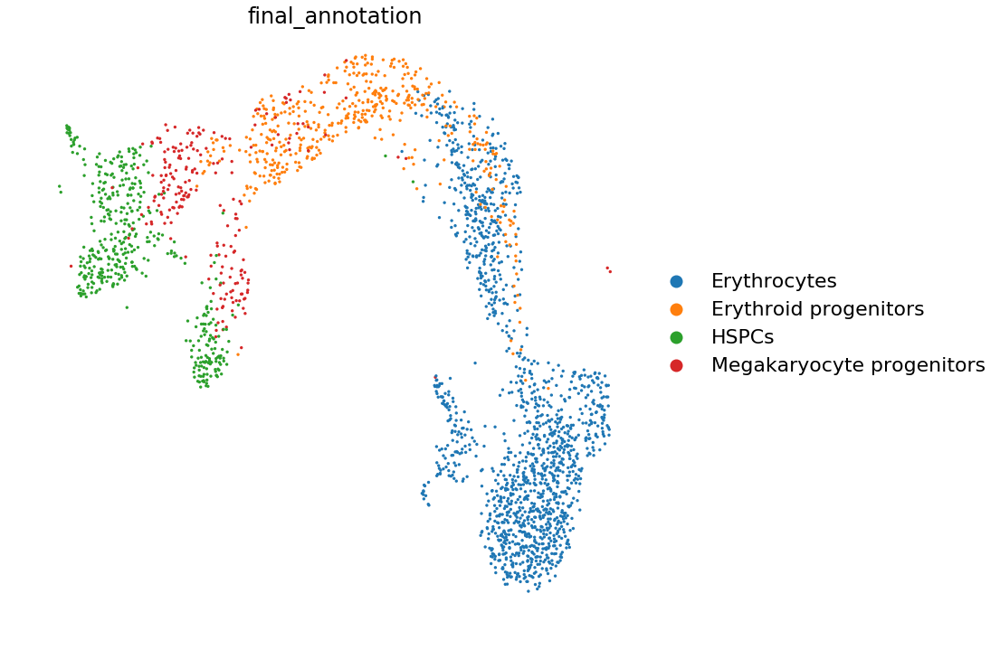

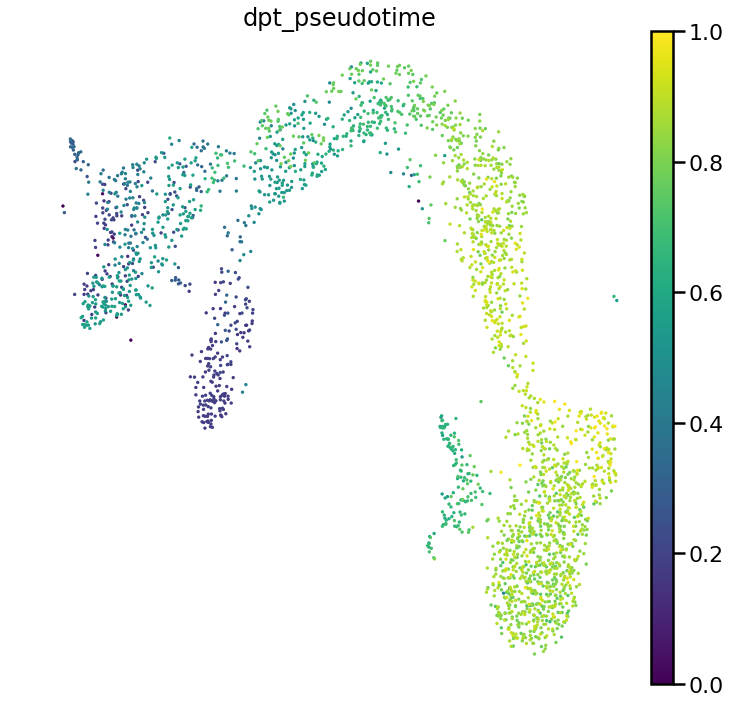

In [200]:
h_out_best_all = final_plot(h_adata_u, h_base, h_best_all, h_best_all_type, save='h_best_all.pdf')

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


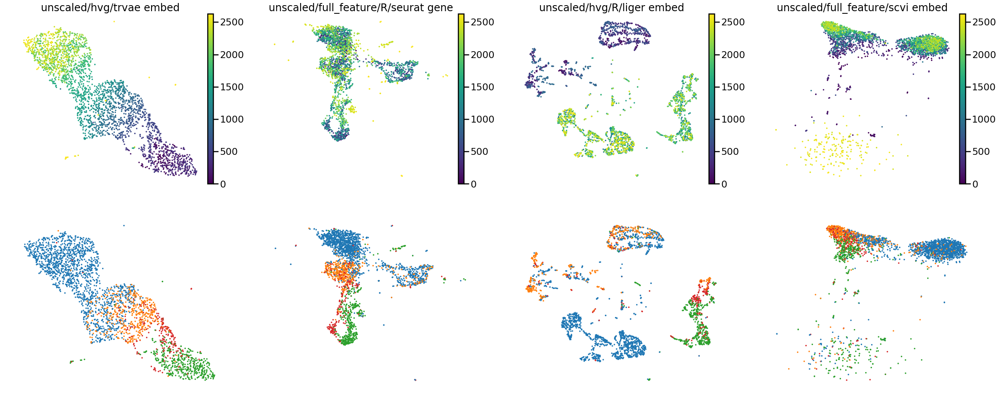

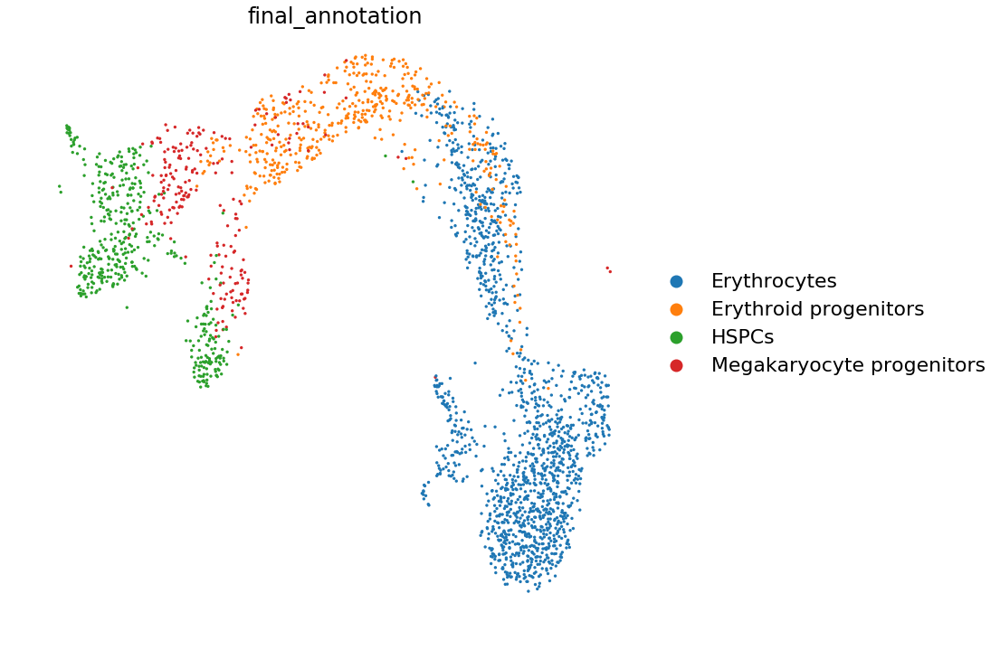

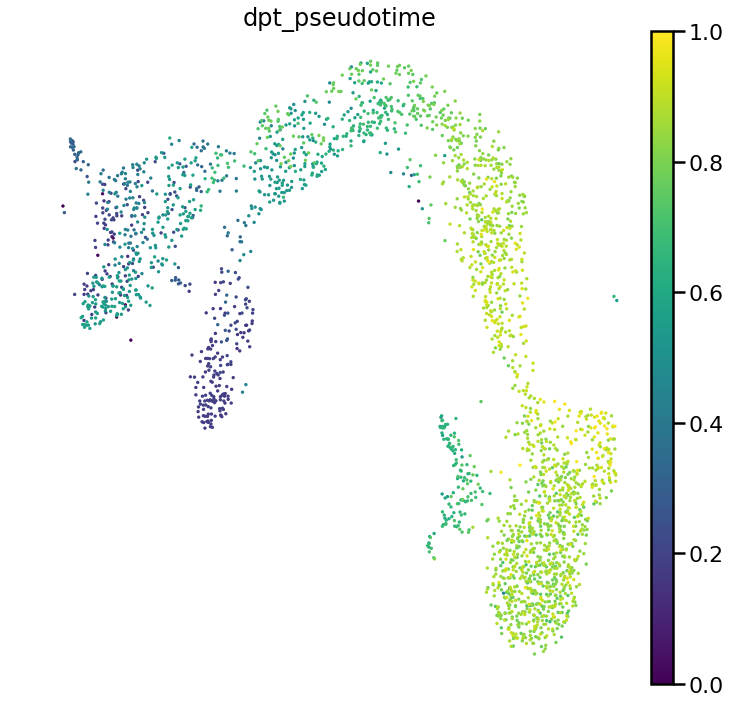

In [221]:
h_out_worst_all = final_plot(h_adata_u, h_base, h_worst_all, h_worst_all_type, save='h_worst_all.pdf')

scaled/hvg/scanorama embed
unscaled/hvg/R/conos knn
conos draw graph
unscaled/hvg/bbknn knn
unscaled/hvg/R/harmony embed


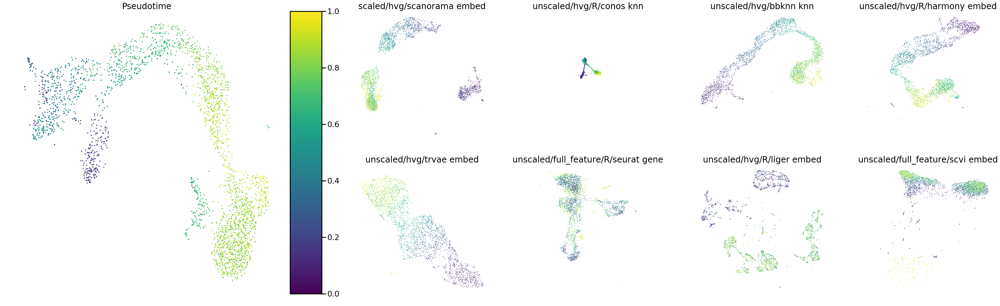

In [223]:
fig, a1 = make_grid()
sc.pl.umap(h_out_best_all[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='DPT Pseudotime')
viz(h_out_best_all[1], h_out_worst_all[1], 'dpt_after', a1)

scaled/hvg/scanorama embed
unscaled/hvg/R/conos knn
unscaled/hvg/bbknn knn
unscaled/hvg/R/harmony embed


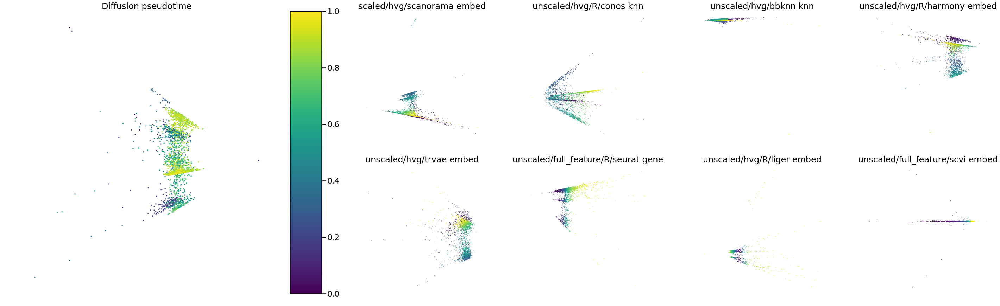

In [376]:
fig, a1 = make_grid()
#sc.pl.umap(h_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Cell type')
sc.tl.diffmap(h_out_best_all[0])
sc.pl.diffmap(h_out_best_all[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Diffusion pseudotime', components=[0,3])
viz(h_out_best_all[1], h_out_worst_all[1], 'dpt_after', a1, diffmap=True)

scaled/hvg/scanorama embed
unscaled/hvg/R/conos knn
unscaled/hvg/bbknn knn
unscaled/hvg/R/harmony embed


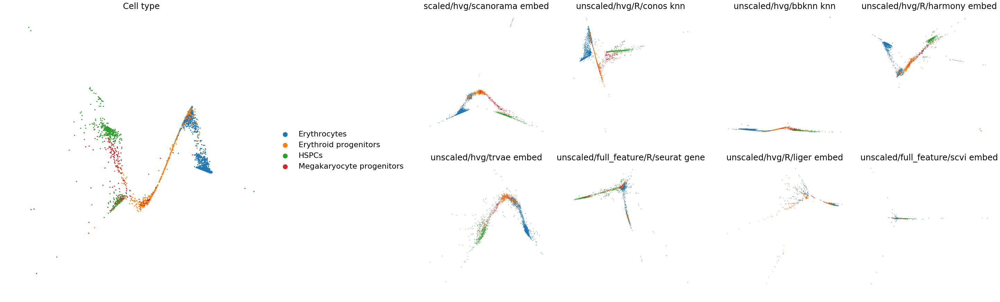

In [374]:
fig, a1 = make_grid()
#sc.pl.umap(h_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Cell type')
#sc.tl.diffmap(h_out_best_all[0])
sc.pl.diffmap(h_out_best_all[0], color='final_annotation', ax=a1[0], frameon=False, show=False, title='Cell type', components=[1,3])
viz(h_out_best_all[1], h_out_worst_all[1], 'final_annotation', a1, diffmap=True)

scaled/hvg/scanorama embed
unscaled/hvg/R/conos knn
conos draw graph
unscaled/hvg/bbknn knn
unscaled/hvg/R/harmony embed


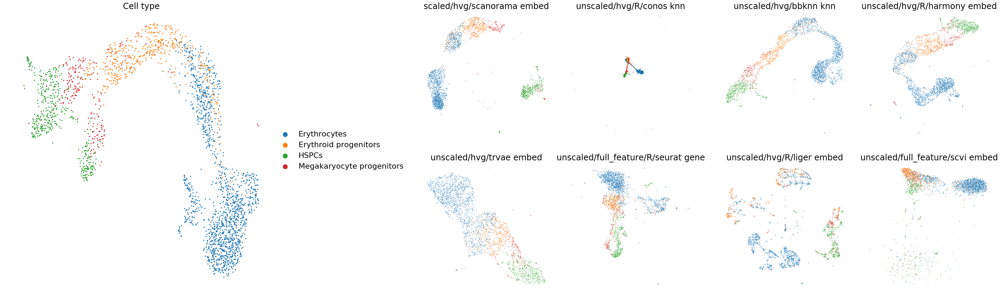

In [224]:
fig, a1 = make_grid()
sc.pl.umap(h_out_best_all[0], color='final_annotation', ax=a1[0], frameon=False, show=False, title='Cell type')
viz(h_out_best_all[1], h_out_worst_all[1], 'final_annotation', a1)

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


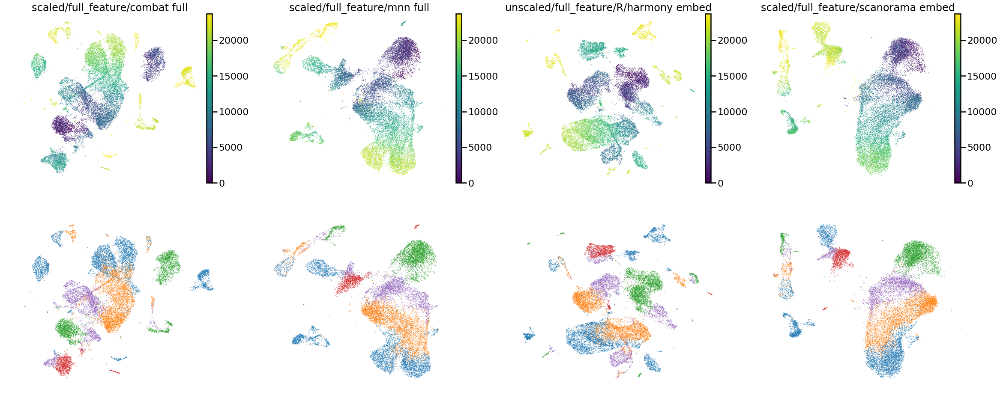

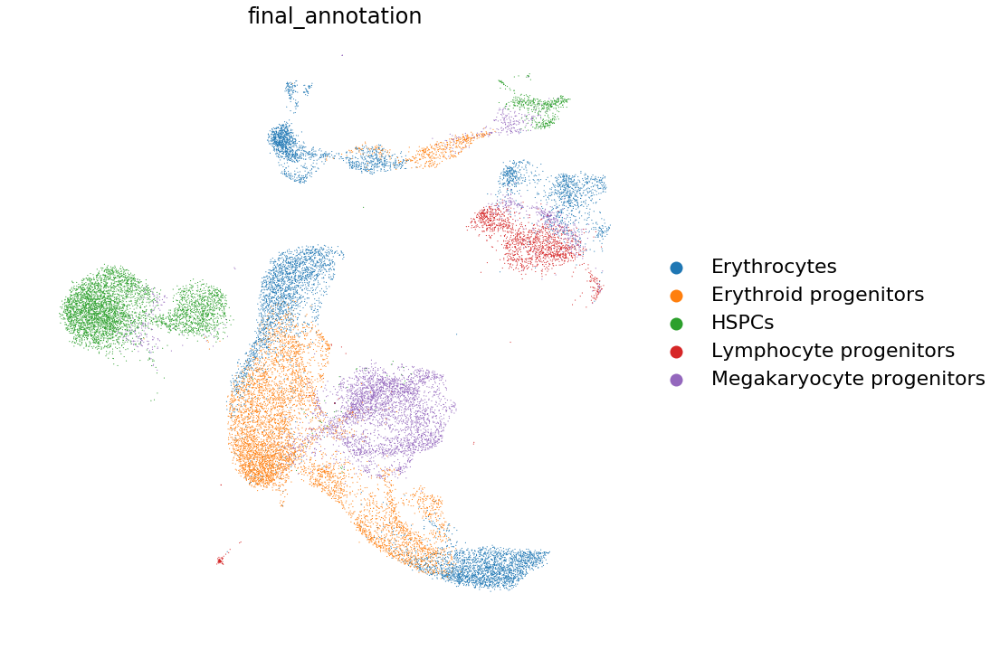

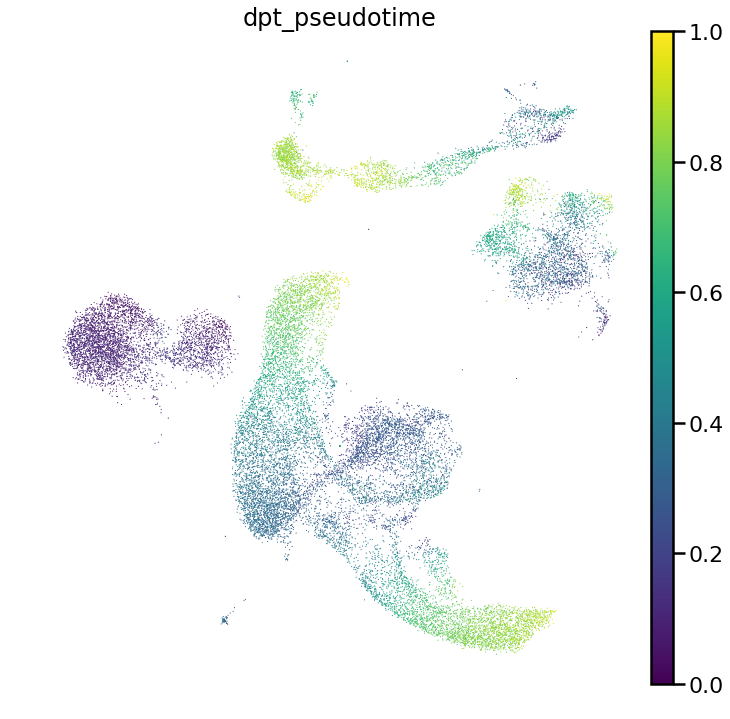

In [99]:
hm_out_best = final_plot(hm_adata_u, hm_base, hm_methods_best, hm_types_best, save='hm_best.pdf', changeCT=True)

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


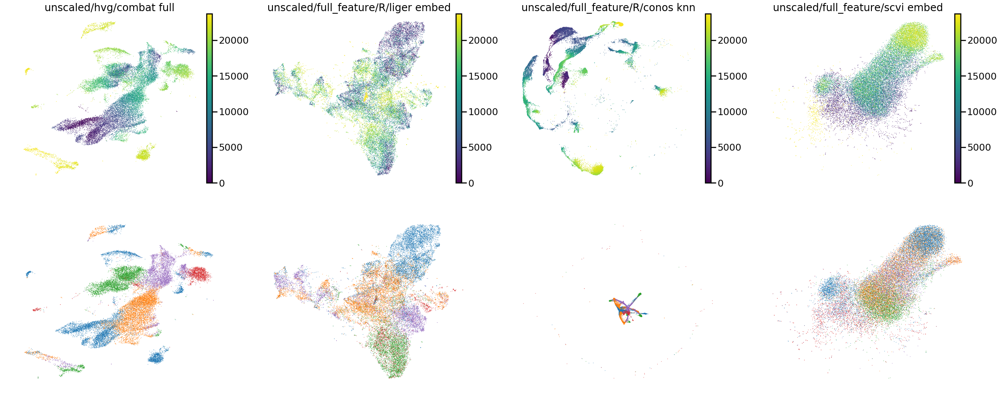

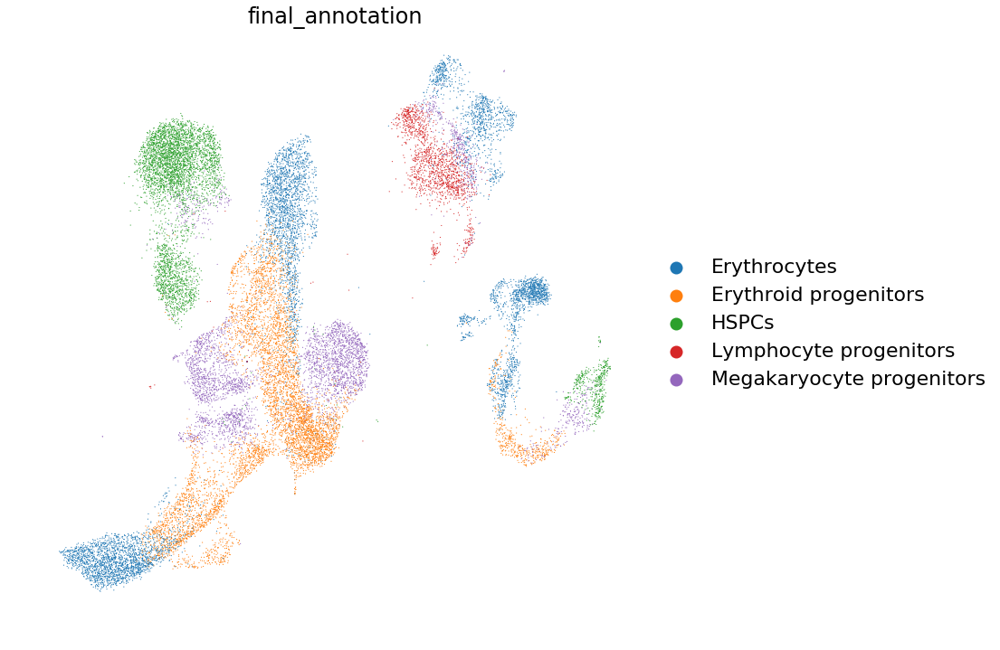

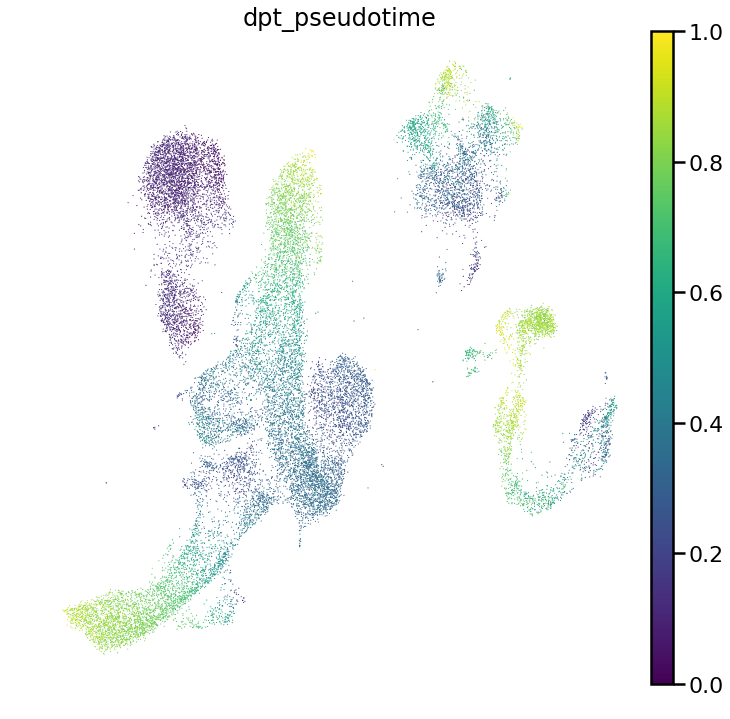

In [100]:
hm_out_worst = final_plot(hm_adata_u, hm_base, hm_methods_worst, hm_types_worst, save='hm_worst.pdf', changeCT=True)

In [101]:
hm_out_best[0].obs.dpt_pseudotime.corr(hm_out_best[1]['scaled/full_feature/combat full'].obs.dpt_pseudotime, method='spearman')

0.8400654474103338

In [215]:
hm_out_best[0].obs['final_annotation'] = hm_out_best[0].obs.final_annotation.cat.remove_unused_categories()

In [218]:
change_ct(hm_out_best[0])
for i in hm_out_best[1].values():
    change_ct(i)

In [219]:
change_ct(hm_out_worst[0])
for i in hm_out_worst[1].values():
    change_ct(i)

scaled/full_feature/combat full
scaled/full_feature/mnn full
unscaled/full_feature/R/harmony embed
scaled/full_feature/scanorama embed
conos draw graph


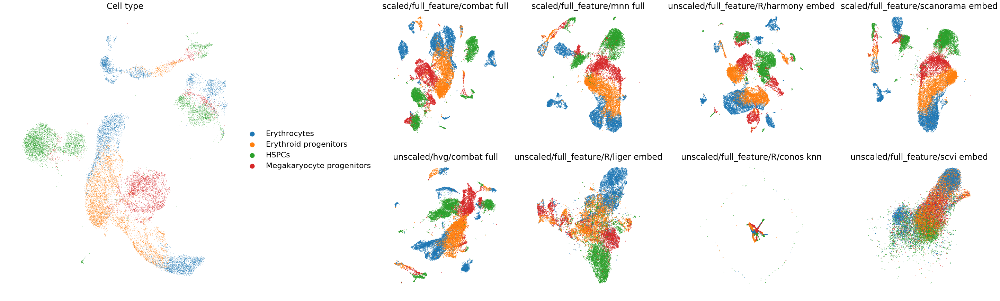

In [220]:
fig, a1 = make_grid()
sc.pl.umap(hm_out_best[0], color='final_annotation', ax=a1[0], frameon=False, show=False, title='Cell type')
viz(hm_out_best[1], hm_out_worst[1], 'final_annotation', a1)


scaled/full_feature/combat full
scaled/full_feature/mnn full
unscaled/full_feature/R/harmony embed
scaled/full_feature/scanorama embed
conos draw graph


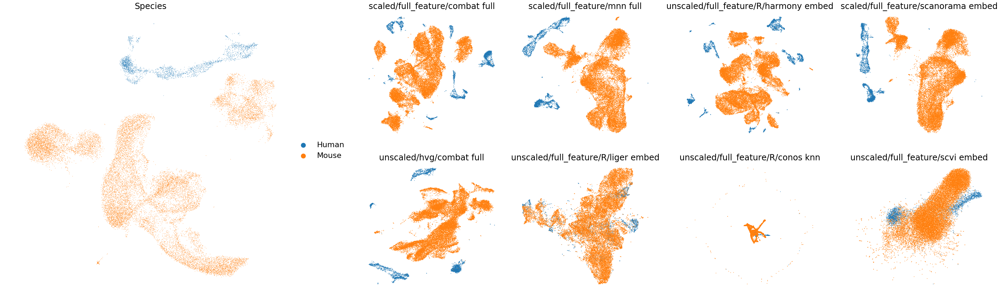

In [193]:
fig, a1 = make_grid()
sc.pl.umap(hm_out_best[0], color='species', ax=a1[0], frameon=False, show=False, title='Species')
viz(hm_out_best[1], hm_out_worst[1], 'species', a1)

scaled/full_feature/combat full
scaled/full_feature/mnn full
unscaled/full_feature/R/harmony embed
scaled/full_feature/scanorama embed
conos draw graph


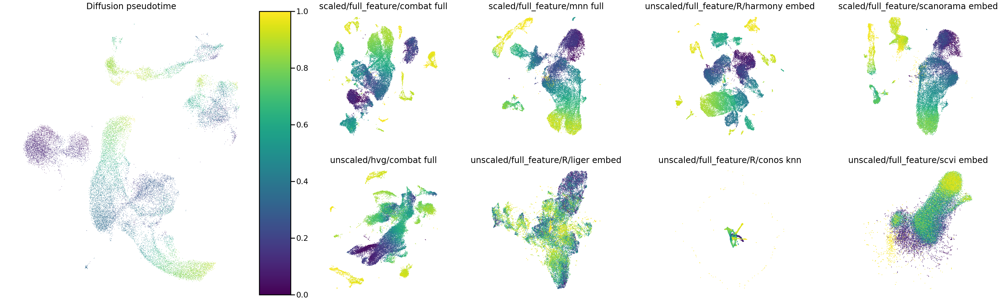

In [194]:
fig, a1 = make_grid()
sc.pl.umap(hm_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Diffusion pseudotime')
#fig_u = plt.gcf()
#fig_u.subplots_adjust(left=1, right=1.1)
viz(hm_out_best[1], hm_out_worst[1], 'dpt_after', a1)


scaled/full_feature/combat full
scaled/full_feature/mnn full
unscaled/full_feature/R/harmony embed
scaled/full_feature/scanorama embed


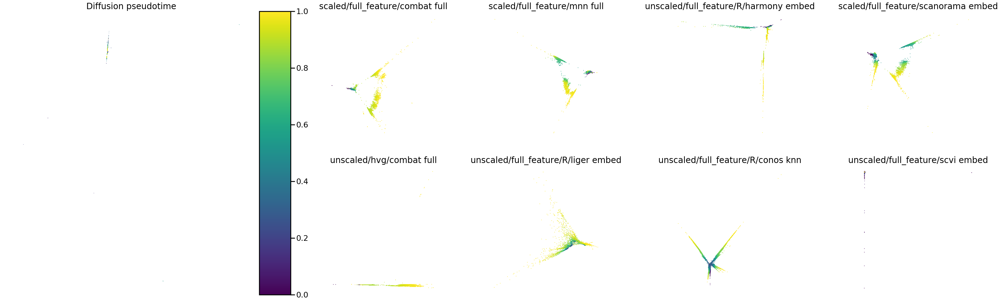

In [300]:
fig, a1 = make_grid()
#sc.pl.umap(h_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Cell type')
sc.tl.diffmap(hm_out_best[0])
sc.pl.diffmap(hm_out_best[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Diffusion pseudotime')
viz(hm_out_best[1], hm_out_worst[1], 'dpt_after', a1, diffmap=True)

In [ ]:
hm_best_all_out = final_plot(hm_adata_u, hm_base, hm_best_all, hm_best_all_type, save='hm_best_all.pdf')

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.obs` of view, copying.


In [415]:
out[1][0].obs[out[1][0].obs.final_annotation == 'Lymphocyte progenitors']['final_annotation']='HSPCs'

In [420]:
out[1][0].obs.loc[out[1][0].obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'

In [425]:
for i in out[1].values():
    i.obs.loc[i.obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'
out[0].obs.loc[out[0].obs.final_annotation == 'Lymphocyte progenitors', 'final_annotation'] = 'HSPCs'

In [ ]:
hm_worst_all_out = final_plot(hm_adata_u, hm_base, hm_worst_all, hm_worst_all_type, save='hm_worst_all.pdf')

scaled/hvg/scanorama embed
unscaled/hvg/bbknn knn
unscaled/full_feature/combat full
scaled/hvg/mnn full
conos draw graph


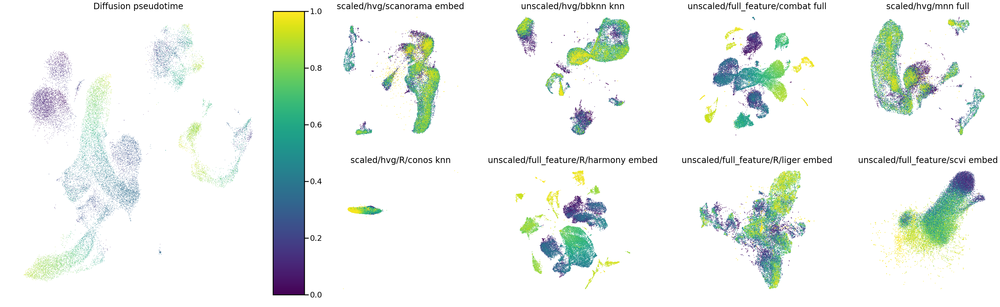

In [229]:
fig, a1 = make_grid()
sc.pl.umap(hm_best_all_out[0], color='dpt_pseudotime', ax=a1[0], frameon=False, show=False, title='Diffusion pseudotime')
#fig_u = plt.gcf()
#fig_u.subplots_adjust(left=1, right=1.1)
viz(hm_best_all_out[1], hm_worst_all_out[1], 'dpt_after', a1)

In [232]:
change_ct(hm_best_all_out[0])
for i in hm_best_all_out[1].values():
    change_ct(i)
    
change_ct(hm_worst_all_out[0])
for i in hm_worst_all_out[1].values():
    change_ct(i)

scaled/hvg/scanorama embed
unscaled/hvg/bbknn knn
unscaled/full_feature/combat full
scaled/hvg/mnn full
conos draw graph


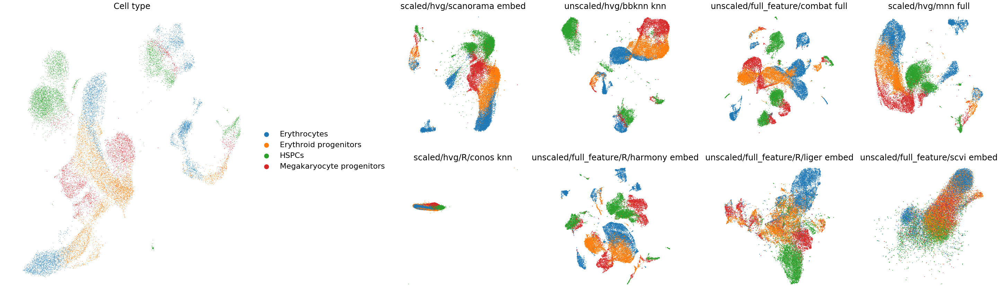

In [233]:
fig, a1 = make_grid()
sc.pl.umap(hm_best_all_out[0], color='final_annotation', ax=a1[0], frameon=False, show=False, title='Cell type')
#fig_u = plt.gcf()
#fig_u.subplots_adjust(left=1, right=1.1)
viz(hm_best_all_out[1], hm_worst_all_out[1], 'final_annotation', a1)

scaled/hvg/scanorama embed
unscaled/hvg/bbknn knn
unscaled/full_feature/combat full
scaled/hvg/mnn full
conos draw graph


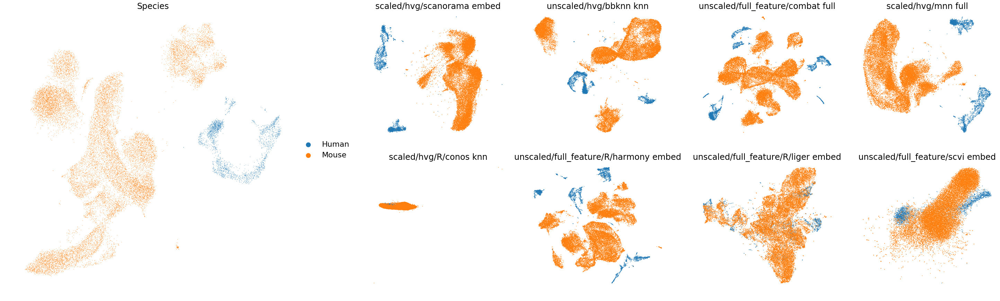

In [231]:
fig, a1 = make_grid()
sc.pl.umap(hm_best_all_out[0], color='species', ax=a1[0], frameon=False, show=False, title='Species')
#fig_u = plt.gcf()
#fig_u.subplots_adjust(left=1, right=1.1)
viz(hm_best_all_out[1], hm_worst_all_out[1], 'species', a1)

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.obs` of view, copying.


Trying to set attribute `.uns` of view, copying.


PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


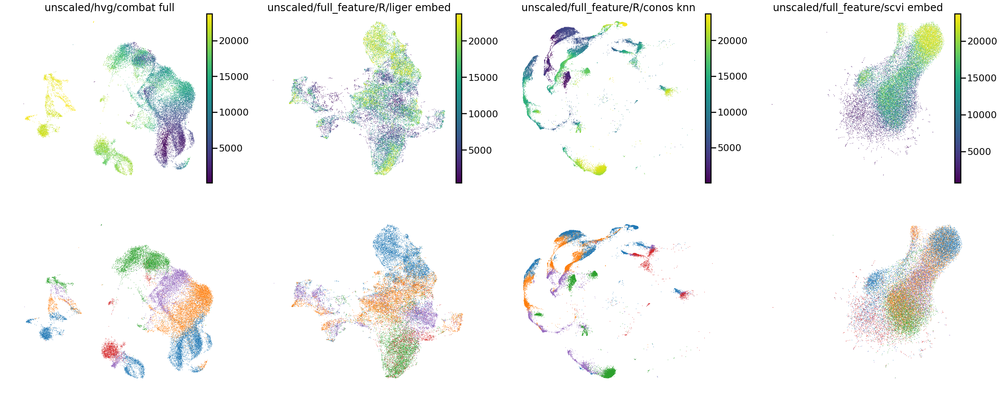

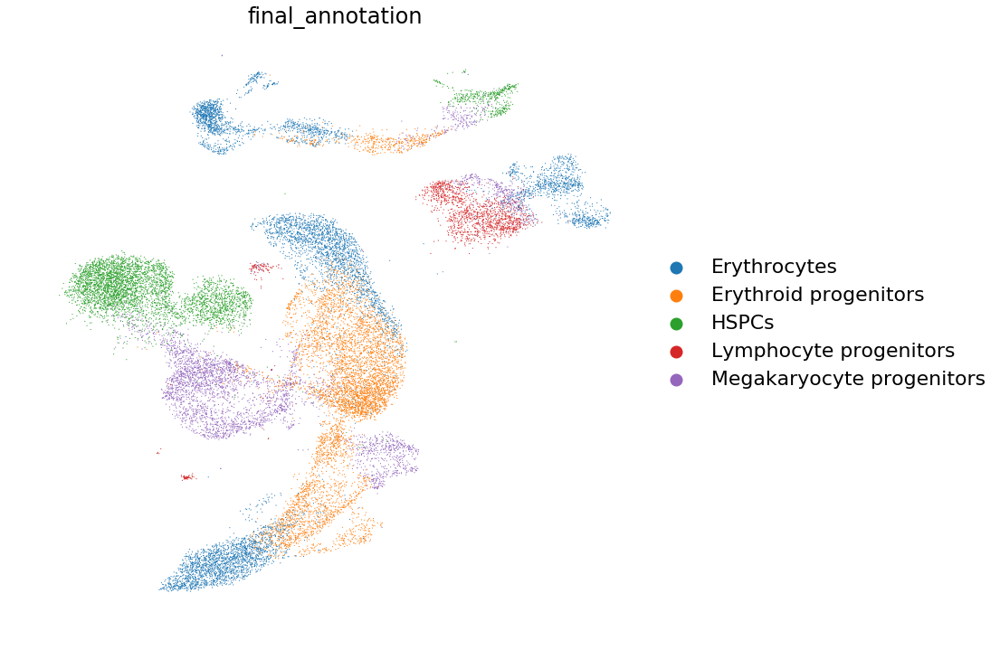

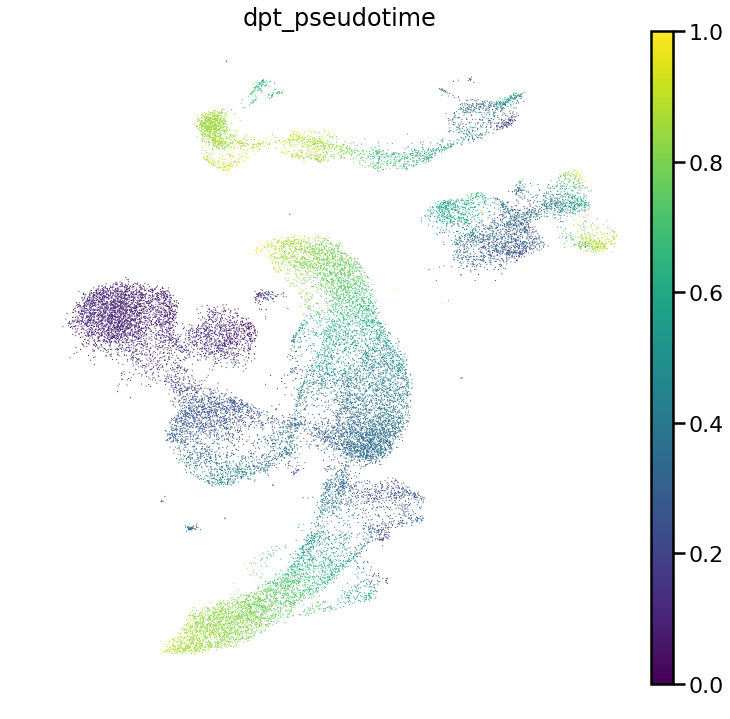

In [374]:
out = final_plot(hm_adata_u, hm_base, hm_methods_worst, hm_types_worst, save='hm_worst.pdf')

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components
Trying to set attribute `.obs` of view, copying.


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning:

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


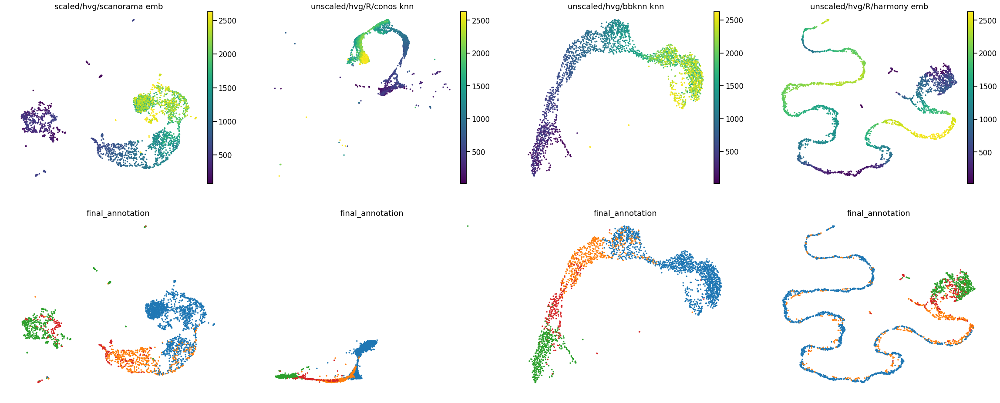

In [310]:
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(h_best_all)):
    tmp = sc.read(base+h_best_all[i])
    _, post = trajectory_plot(adata_u, tmp, 'final_annotation', h_best_all_type[i], h_best_all[i].split(".")[0]+" "+h_best_all_type[i], ax=axs[0,start], orig=True)
    if 'conos' in h_best_all[i]:
        sc.pl.draw_graph(post, color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc='on_data')
    else:
        sc.pl.umap(post, color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc="on_data")
    start +=1

PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


Trying to set attribute `.obs` of view, copying.


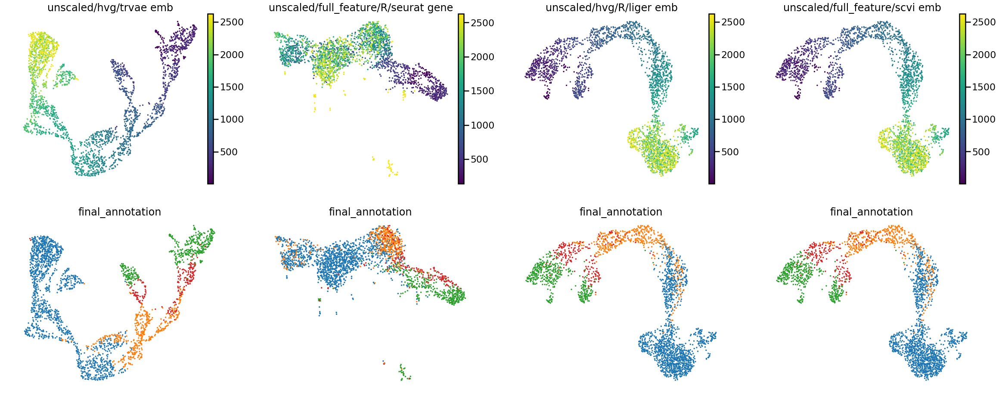

In [356]:
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(h_worst_all)):
    tmp = sc.read(base+h_worst_all[i])
    _, post = trajectory_plot(adata_u, tmp, 'final_annotation', h_worst_all_type[i], h_worst_all[i].split(".")[0]+" "+h_worst_all_type[i], ax=axs[0,start], orig=True)
    if 'conos' in h_worst_all[i]:
        sc.pl.draw_graph(post, color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc='on_data')
    else:
        sc.pl.umap(post, color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc="on_data")
    start +=1

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 12 separate connected components using meta-embedding (experimental)
  n_components
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 206 separate connected components using meta-embedding (experimental)
  n_components


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


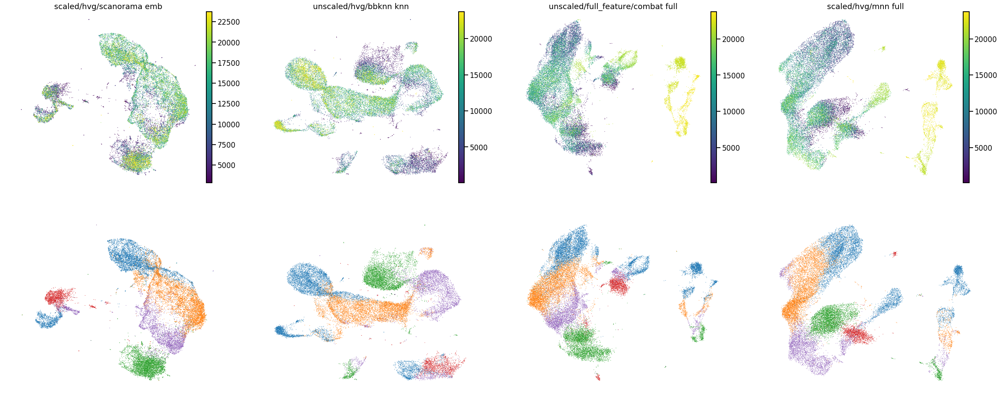

In [314]:
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(hm_best_all)):
    tmp = sc.read(hm_base+hm_best_all[i])
    _, post = trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_best_all_type[i], hm_best_all[i].split(".")[0]+" "+hm_best_all_type[i], ax=axs[0,start], orig=True)
    if 'conos' in hm_best_all[i]:
        sc.pl.draw_graph(post, color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc='on_data', title="")
    else:
        sc.pl.umap(post, color='final_annotation', ax=axs[1,start], show=False, frameon=False, legend_loc="on_data", title="")
    start +=1

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


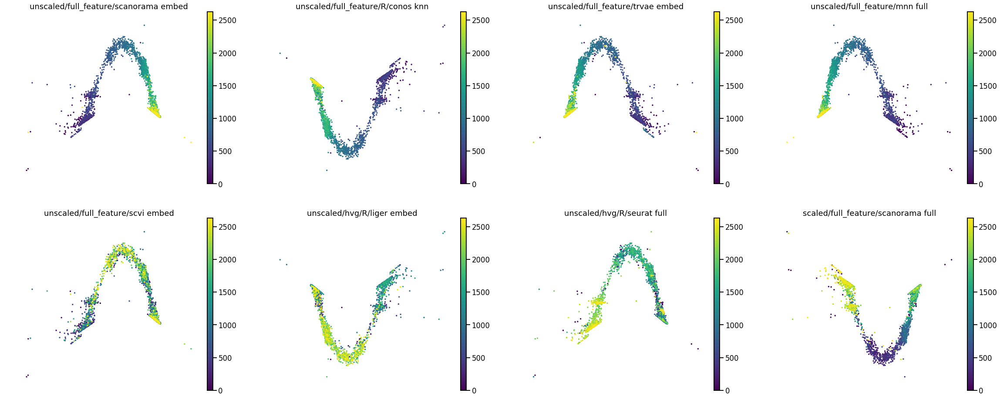

In [158]:
base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(methods_best)):
    tmp = sc.read(base+methods_best[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_best[i], methods_best[i].split(".")[0]+" "+types_best[i], ax=axs[0,start])
    start +=1

start = 0
for i in range(len(methods_worst)):
    tmp = sc.read(base+methods_worst[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_worst[i], methods_worst[i].split(".")[0]+" "+types_worst[i], ax=axs[1,start])
    start +=1

In [ ]:
hm_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum_mou/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(hm_methods_best)):
    tmp = sc.read(hm_base+hm_methods_best[i])
    trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_types_best[i], hm_methods_best[i].split(".")[0]+" "+hm_types_best[i], ax=axs[0,start])
    start +=1
start = 0
for i in range(len(hm_methods_worst)):
    tmp = sc.read(hm_base+hm_methods_worst[i])
    trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_types_worst[i], hm_methods_worst[i].split(".")[0]+" "+hm_types_worst[i], ax=axs[1,start])
    start +=1

HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA


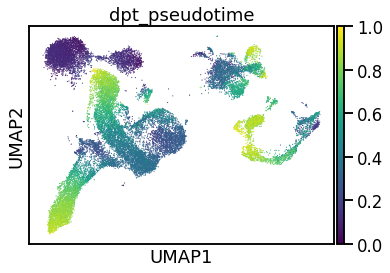

In [260]:
sc.pl.umap(adata_pre_draw, color='dpt_pseudotime')

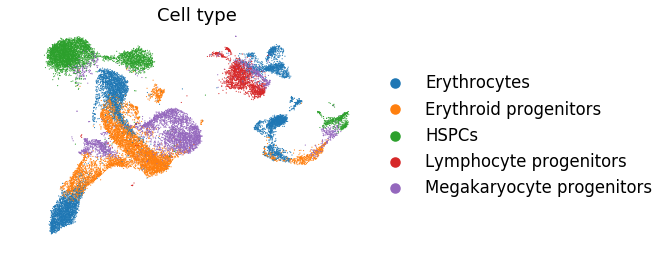

In [328]:
sc.pl.umap(adata_pre_draw, color='final_annotation', frameon=False, palette=sc.pl.palettes.vega_10, title='Cell type')

HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
row.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shap

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


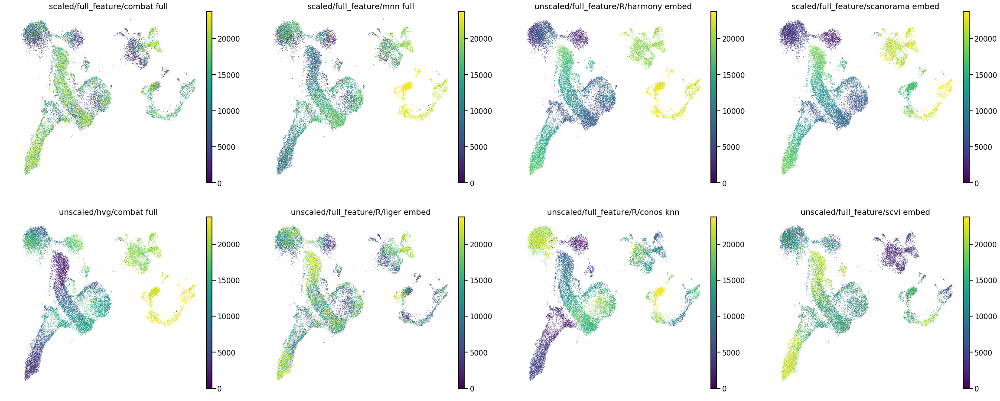

In [258]:
hm_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum_mou/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(hm_methods_best)):
    tmp = sc.read(hm_base+hm_methods_best[i])
    trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_types_best[i], hm_methods_best[i].split(".")[0]+" "+hm_types_best[i], ax=axs[0,start])
    start +=1
start = 0
for i in range(len(hm_methods_worst)):
    tmp = sc.read(hm_base+hm_methods_worst[i])
    trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_types_worst[i], hm_methods_worst[i].split(".")[0]+" "+hm_types_worst[i], ax=axs[1,start])
    start +=1

HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 5 separate connected components using meta-embedding (experimental)
  n_components


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum
r

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


KeyError: 'params'

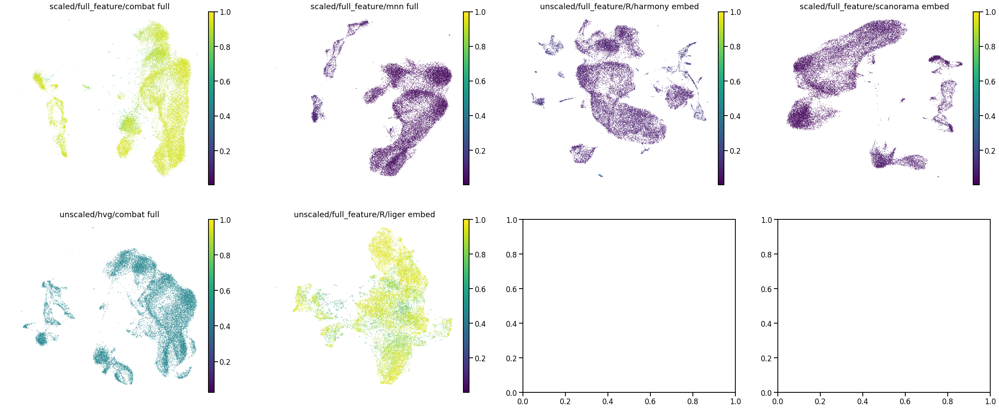

In [291]:
hm_base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum_mou/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(hm_methods_best)):
    tmp = sc.read(hm_base+hm_methods_best[i])
    trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_types_best[i], hm_methods_best[i].split(".")[0]+" "+hm_types_best[i], ax=axs[0,start], orig=True)
    start +=1
start = 0
for i in range(len(hm_methods_worst)):
    tmp = sc.read(hm_base+hm_methods_worst[i])
    trajectory_plot(hm_adata_u, tmp, 'final_annotation', hm_types_worst[i], hm_methods_worst[i].split(".")[0]+" "+hm_types_worst[i], ax=axs[1,start], orig=True)
    start +=1

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


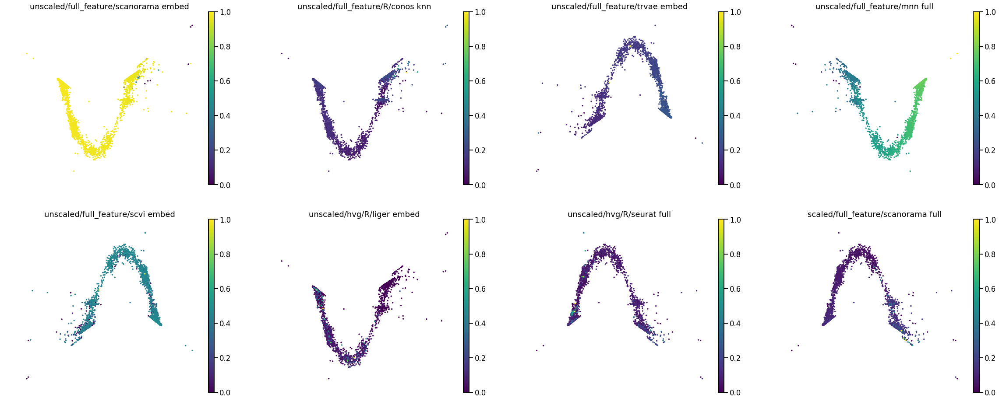

In [139]:
base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(methods_best)):
    tmp = sc.read(base+methods_best[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_best[i], methods_best[i].split(".")[0]+" "+types_best[i], ax=axs[0,start])
    start +=1

start = 0
for i in range(len(methods_worst)):
    tmp = sc.read(base+methods_worst[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_worst[i], methods_worst[i].split(".")[0]+" "+types_worst[i], ax=axs[1,start])
    start +=1

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:754: RuntimeWarning: divide by zero encountered in true_divide
  Q = scipy.sparse.spdiags(1.0/q, 0, W.shape[0], W.shape[0])
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy/neighbors/__init__.py:764: RuntimeWarning: divide by zero encountered in true_divide
  self.Z = scipy.sparse.spdiags(1.0/z, 0, K.shape[0], K.shape[0])


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


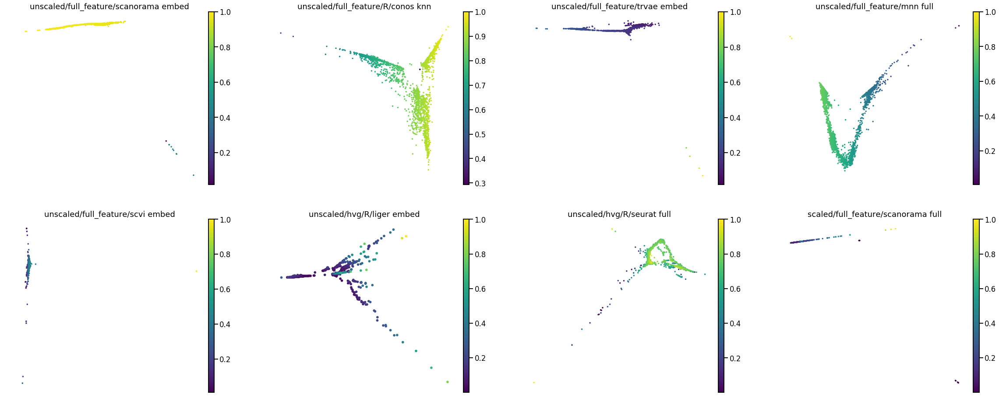

In [174]:
base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(methods_best)):
    tmp = sc.read(base+methods_best[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_best[i], methods_best[i].split(".")[0]+" "+types_best[i], ax=axs[0,start], orig=True)
    start +=1

start = 0
for i in range(len(methods_worst)):
    tmp = sc.read(base+methods_worst[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_worst[i], methods_worst[i].split(".")[0]+" "+types_worst[i], ax=axs[1,start], orig = True)
    start +=1

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


HVG
Calculating 2000 HVGs for reduce_data.
Computed 1999 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))
Trying to set attribute `.obs` of view, copying.
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:41: FutureWarning: 
The current behaviour of 'Series.argmax' is deprecated, use 'idxmax'
instead.
The behavior of 'argmax' will be corrected to return the positional
maximum in the future. For now, use 'series.values.argmax' or
'np.argmax(np.array(values))' to get the position of the maximum

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/ipykernel_launcher.py:83: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


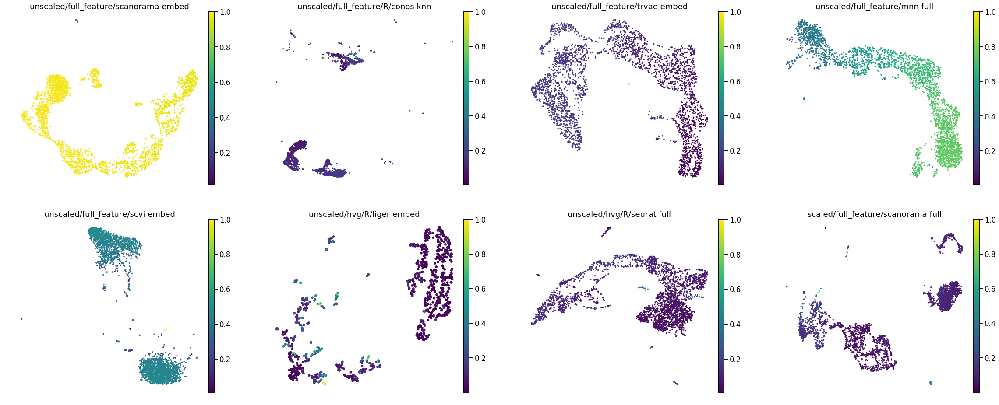

In [295]:
base = '/storage/groups/ml01/workspace/scIB/immune_cell_hum/integration/'
fig, axs = plt.subplots(2, 4, figsize=(40,16))
start = 0
for i in range(len(methods_best)):
    tmp = sc.read(base+methods_best[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_best[i], methods_best[i].split(".")[0]+" "+types_best[i], ax=axs[0,start], orig=True)
    start +=1

start = 0
for i in range(len(methods_worst)):
    tmp = sc.read(base+methods_worst[i])
    trajectory_plot(adata_u, tmp, 'final_annotation', types_worst[i], methods_worst[i].split(".")[0]+" "+types_worst[i], ax=axs[1,start], orig = True)
    start +=1

In [272]:
adata_u = sc.read(unintegrated)

In [276]:
scIB.pp.reduce_data(adata_u)

HVG
Calculating 2000 HVGs for reduce_data.
Computed 2000 highly variable genes
PCA
Nearest Neigbours


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/numba/compiler.py:602: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/nndescent.py", line 47:
    @numba.njit(parallel=True)
    def nn_descent(
    ^

  self.func_ir.loc))


UMAP


/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 3 separate connected components using meta-embedding (experimental)
  n_components


In [329]:
h_adata_draw = adata_u[adata_u.obs.dpt_pseudotime.notnull()]

In [330]:
sc.tl.umap(h_adata_draw)

/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/umap/spectral.py:229: UserWarning: Embedding a total of 2 separate connected components using meta-embedding (experimental)
  n_components


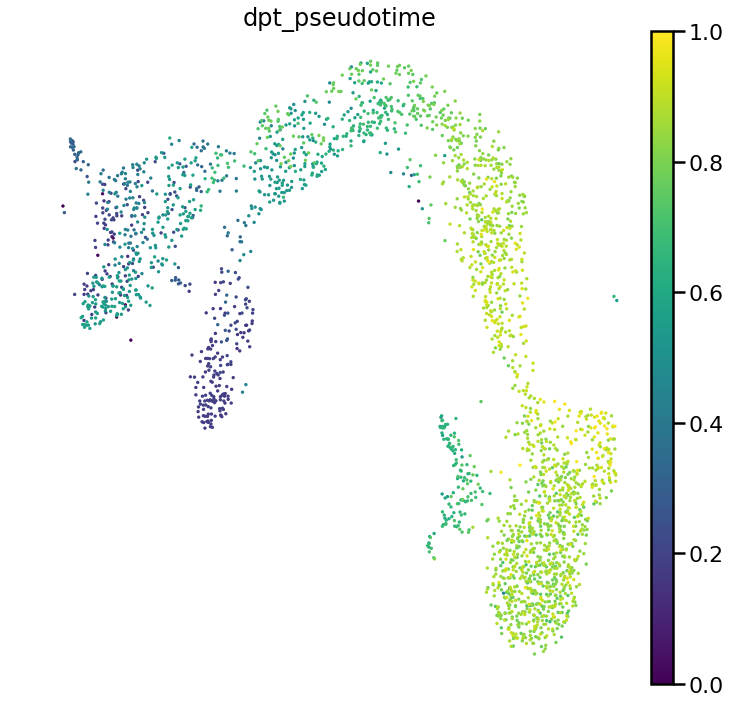

In [349]:
sc.pl.umap(h_adata_draw, color='dpt_pseudotime', frameon=False)

In [85]:
def trajectory_conservation(adata_pre, adata_post, label_key):
    cell_subset = adata_pre.obs.index[adata_pre.obs["dpt_pseudotime"].notnull()]
    adata_pre_sub = adata_pre[cell_subset]
    adata_post_sub = adata_post[cell_subset]
    
    adata_post_sub.uns['iroot'] = get_root(adata_pre_sub, adata_post_sub, label_key)
    
    sc.tl.dpt(adata_post_sub)
    adata_post_sub.obs['dpt_pseudotime'][adata_post_sub.obs['dpt_pseudotime']>1]=0
    adata_post_sub.obs['dpt_before']=adata_pre_sub.obs['dpt_pseudotime']
    return (adata_post_sub.obs['dpt_pseudotime'].corr(adata_pre_sub.obs['dpt_pseudotime'], 'spearman')+1)/2, adata_post_sub

In [512]:
trajectory_conservation(hm_out_best[0], hm_out_best[1]['scaled/full_feature/combat full'], 'final_annotation')

Trying to set attribute `.obs` of view, copying.


0.296976069463619

In [80]:
combat = sc.read ('/home/icb/daniel.strobl/Benchmarking_data_integration/workspace/immune_cell_hum_mou/integration/scaled/full_feature/combat.h5ad')

In [81]:
orig = sc.read('/storage/groups/ml01/workspace/group.daniela/immune_cells/Immune_ALL_hum_mou.h5ad')

In [82]:
run_pp(orig, combat, 'final_annotation', 'study')

PCA
Nearest Neigbours


In [86]:
out_tra = trajectory_conservation(orig, combat, 'final_annotation')

Trying to set attribute `.obs` of view, copying.


In [83]:
scIB.metrics.trajectory_conservation(orig, combat, 'final_annotation')

Trying to set attribute `.obs` of view, copying.


0.9227789624373697

In [535]:
out_tra

(0.7173618526737922, AnnData object with n_obs × n_vars = 23728 × 8135 
     obs: 'batch', 'chemistry', 'data_type', 'dpt_pseudotime', 'final_annotation', 'mt_frac', 'n_counts', 'n_genes', 'size_factors', 'species', 'study', 'tissue', 'neighborhood', 'dpt_before'
     var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
     uns: 'pca', 'neighbors', 'diffmap_evals', 'iroot'
     obsm: 'X_pca', 'X_diffmap'
     varm: 'PCs'
     layers: 'counts')

In [522]:
out_tra[1]

AnnData object with n_obs × n_vars = 23728 × 8135 
    obs: 'batch', 'chemistry', 'data_type', 'dpt_pseudotime', 'final_annotation', 'mt_frac', 'n_counts', 'n_genes', 'size_factors', 'species', 'study', 'tissue', 'neighborhood'
    var: 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'pca', 'neighbors', 'diffmap_evals', 'iroot'
    obsm: 'X_pca', 'X_diffmap'
    varm: 'PCs'
    layers: 'counts'

In [87]:
sc.tl.umap(out_tra[1])

In [88]:
out_tra[1].obs['dpt_after'] = pd.Series(range(len(out_tra[1].obs)), index=out_tra[1].obs.sort_values('dpt_pseudotime').index)

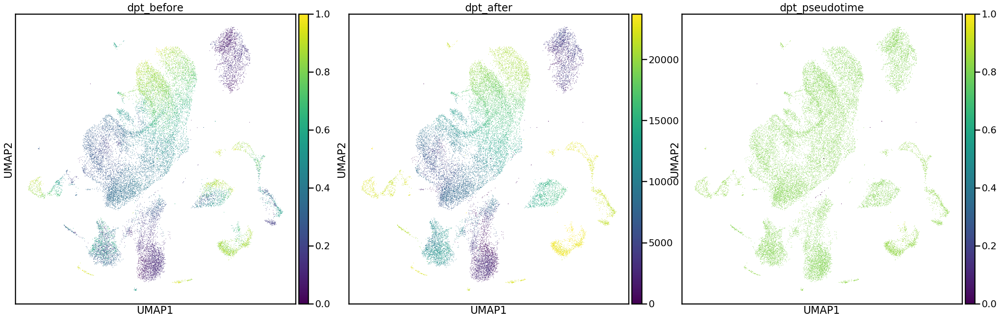

In [89]:
sc.pl.umap(out_tra[1], color=['dpt_before', 'dpt_after', 'dpt_pseudotime'])

In [541]:
(out_tra[1].obs.dpt_pseudotime.corr(out_tra[1].obs.dpt_after)+1)/2

0.7349748129430718

In [546]:
dat = pd.read_csv('/home/icb/daniel.strobl/Benchmarking_data_integration/workspace/metrics_2.csv')

In [552]:
dat[dat['Unnamed: 0']== '/immune_cell_hum_mou/metrics/scaled/full_feature/combat_full']

,Unnamed: 0,NMI_cluster/label,ARI_cluster/label,ASW_label,ASW_label/batch,PCR_batch,cell_cycle_conservation,isolated_label_F1,isolated_label_silhouette,graph_conn,kBET,iLISI,cLISI,hvg_overlap,trajectory
223,/immune_cell_hum_mou/metrics/scaled/full_feature/combat_full,0.606668,0.321191,0.454931,0.903349,1.0,0.800576,0.202992,0.365562,0.821845,0.001077,1.010775,0.833723,0.057814,0.922775


In [56]:
sc.__path__

['/home/icb/daniel.strobl/miniconda3/envs/sc-tutorial/lib/python3.7/site-packages/scanpy']